# Basic draw(line, text, shape)


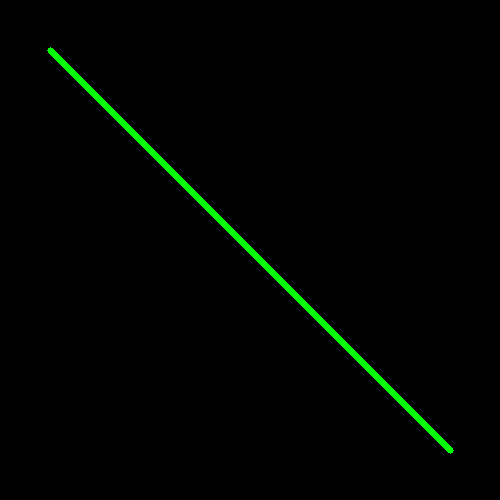

Image with a Green Line:


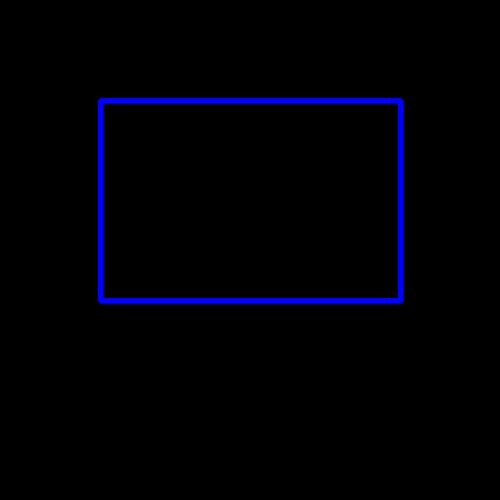

Image with a Blue Rectangle:


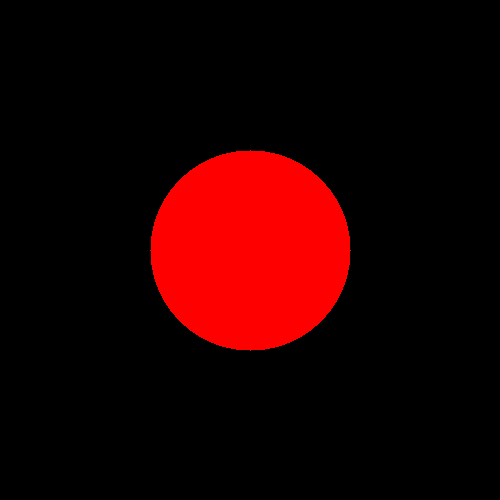

Image with a Filled Red Circle:


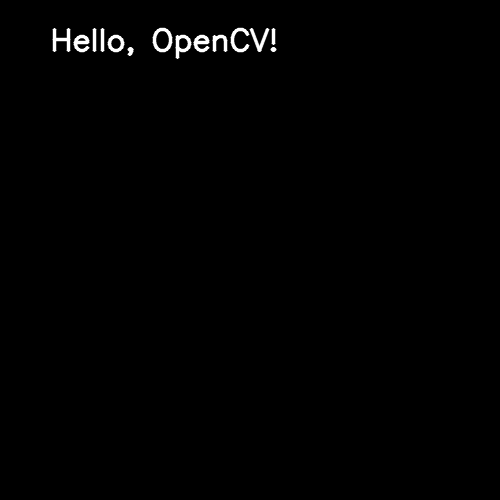

Image with White Text:


In [1]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Create a blank black image (or load an existing one)
# Let's create a 500x500 black image
height, width = 500, 500
blank_img = np.zeros((height, width, 3), dtype=np.uint8)

# --- Draw a Line ---
# cv2.line(image, start_point, end_point, color, thickness)
start_point = (50, 50)
end_point = (450, 450)
color_line = (0, 255, 0) # Green in BGR
thickness_line = 5
img_with_line = blank_img.copy()
cv2.line(img_with_line, start_point, end_point, color_line, thickness_line)
cv2_imshow(img_with_line)
print("Image with a Green Line:")


# --- Draw a Rectangle ---
# cv2.rectangle(image, start_point, end_point, color, thickness)
# start_point is the top-left corner, end_point is the bottom-right corner
start_point_rect = (100, 100)
end_point_rect = (400, 300)
color_rect = (255, 0, 0) # Blue in BGR
thickness_rect = 3 # Use -1 for a filled rectangle
img_with_rect = blank_img.copy()
cv2.rectangle(img_with_rect, start_point_rect, end_point_rect, color_rect, thickness_rect)
cv2_imshow(img_with_rect)
print("Image with a Blue Rectangle:")

# --- Draw a Circle ---
# cv2.circle(image, center_coordinates, radius, color, thickness)
center_coords = (250, 250)
radius = 100
color_circle = (0, 0, 255) # Red in BGR
thickness_circle = -1 # Use -1 for a filled circle
img_with_circle = blank_img.copy()
cv2.circle(img_with_circle, center_coords, radius, color_circle, thickness_circle)
cv2_imshow(img_with_circle)
print("Image with a Filled Red Circle:")

# --- Put Text on an Image ---
# cv2.putText(image, text, org, fontFace, fontScale, color, thickness, lineType)
text = "Hello, OpenCV!"
org = (50, 50) # Bottom-left corner of the text string
font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 1
color_text = (255, 255, 255) # White in BGR
thickness_text = 2
img_with_text = blank_img.copy()
cv2.putText(img_with_text, text, org, font, font_scale, color_text, thickness_text, cv2.LINE_AA)
cv2_imshow(img_with_text)
print("Image with White Text:")

# Image rotate


Using a sample image for transformations.


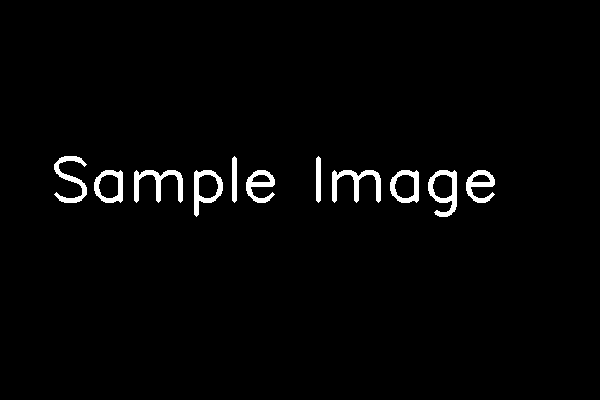

Original Image:


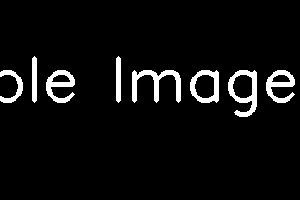

Cropped Image (300x200):


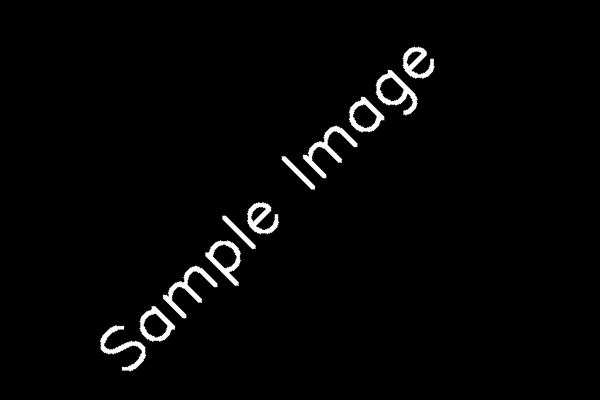

Rotated Image (45 degrees):


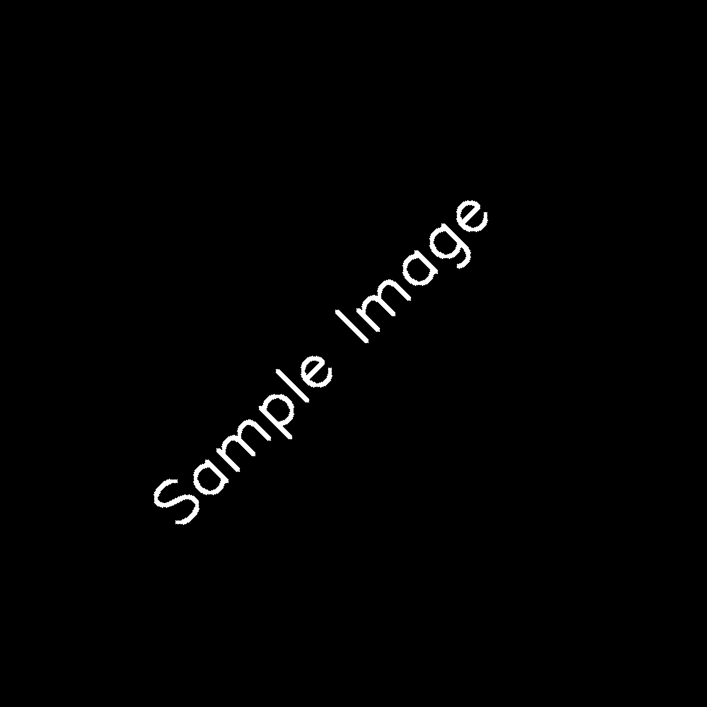

Rotated Image (45 degrees, full view):


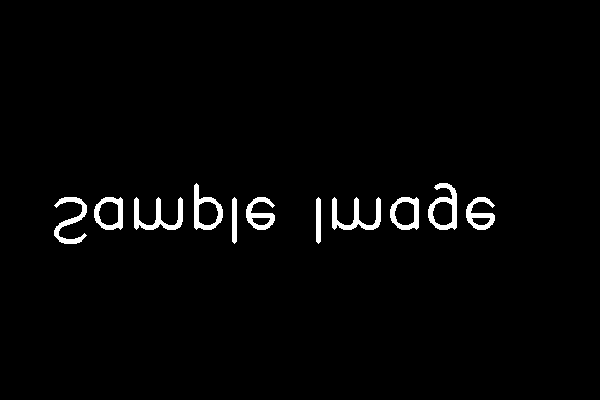

Vertically Flipped Image:


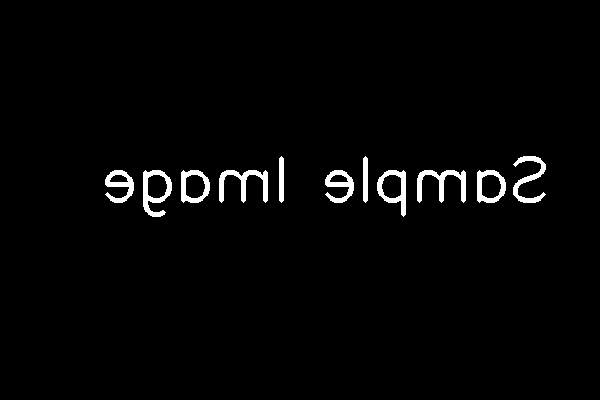

Horizontally Flipped Image:


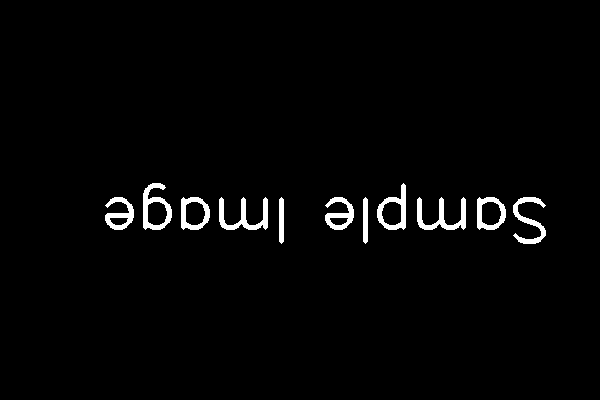

Flipped around both axes:


In [2]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Assuming 'img' is already loaded (e.g., from the fruit image URL)
# If not, you can load an image from a file or create a blank one
# img = cv2.imread('your_image.jpg')
# if img is None:
#     print("Error loading image")
#     exit()

# Let's use the 'img' variable from the previous cells
if 'img' in globals() and img is not None:
    image_to_transform = img.copy()
else:
    # Create a sample image if 'img' is not available
    print("Using a sample image for transformations.")
    image_to_transform = np.zeros((400, 600, 3), dtype=np.uint8)
    cv2.putText(image_to_transform, "Sample Image", (50, 200), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 255, 255), 3)


cv2_imshow(image_to_transform)
print("Original Image:")

# --- Cropping an Image ---
# Cropping is done by slicing the NumPy array
# img[y_start:y_end, x_start:x_end]
y_start, y_end = 100, 300
x_start, x_end = 200, 500
cropped_img = image_to_transform[y_start:y_end, x_start:x_end]
cv2_imshow(cropped_img)
print(f"Cropped Image ({cropped_img.shape[1]}x{cropped_img.shape[0]}):")


# --- Rotating an Image ---
# Get the image center for rotation
height, width = image_to_transform.shape[:2]
center = (width // 2, height // 2)

# Define the rotation matrix
# cv2.getRotationMatrix2D(center, angle, scale)
angle = 45 # Degrees
scale = 1.0
M_rotate = cv2.getRotationMatrix2D(center, angle, scale)

# Apply the rotation
# cv2.warpAffine(image, M, (width, height))
rotated_img = cv2.warpAffine(image_to_transform, M_rotate, (width, height))
cv2_imshow(rotated_img)
print(f"Rotated Image ({angle} degrees):")

# Rotating while keeping the whole image visible (can result in larger dimensions)
# Calculate new bounding dimensions
abs_cos = abs(M_rotate[0, 0])
abs_sin = abs(M_rotate[0, 1])
new_width = int(height * abs_sin + width * abs_cos)
new_height = int(height * abs_cos + width * abs_sin)

# Adjust the rotation matrix to shift the center
M_rotate[0, 2] += (new_width / 2) - center[0]
M_rotate[1, 2] += (new_height / 2) - center[1]

rotated_img_full = cv2.warpAffine(image_to_transform, M_rotate, (new_width, new_height))
cv2_imshow(rotated_img_full)
print(f"Rotated Image ({angle} degrees, full view):")


# --- Flipping an Image ---
# cv2.flip(image, flipCode)
# flipCode = 0: flip around the x-axis (vertical flip)
# flipCode > 0: flip around the y-axis (horizontal flip)
# flipCode < 0: flip around both axes

flipped_vertical = cv2.flip(image_to_transform, 0)
cv2_imshow(flipped_vertical)
print("Vertically Flipped Image:")

flipped_horizontal = cv2.flip(image_to_transform, 1)
cv2_imshow(flipped_horizontal)
print("Horizontally Flipped Image:")

flipped_both = cv2.flip(image_to_transform, -1)
cv2_imshow(flipped_both)
print("Flipped around both axes:")

# Color sapce and color segment

In [3]:
fruit_img_url = "https://cdn.beautifulpuzzle.com/photos/fresh-fruits-and-vegetables.jpg"

In [4]:
import requests
from io import BytesIO
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

In [5]:
def url2bytes(url):
  # Fetch the image from the URL
  response = requests.get(url)
  response.raise_for_status() # Raise an exception for bad status codes

  # Store the image in BytesIO
  image_bytes = BytesIO(response.content)

  # Read the image into OpenCV
  # Convert the BytesIO object to a numpy array
  image_array = np.asarray(bytearray(image_bytes.read()), dtype=np.uint8)
  # Decode the numpy array into an OpenCV image
  img = cv2.imdecode(image_array, cv2.IMREAD_COLOR)

  return img

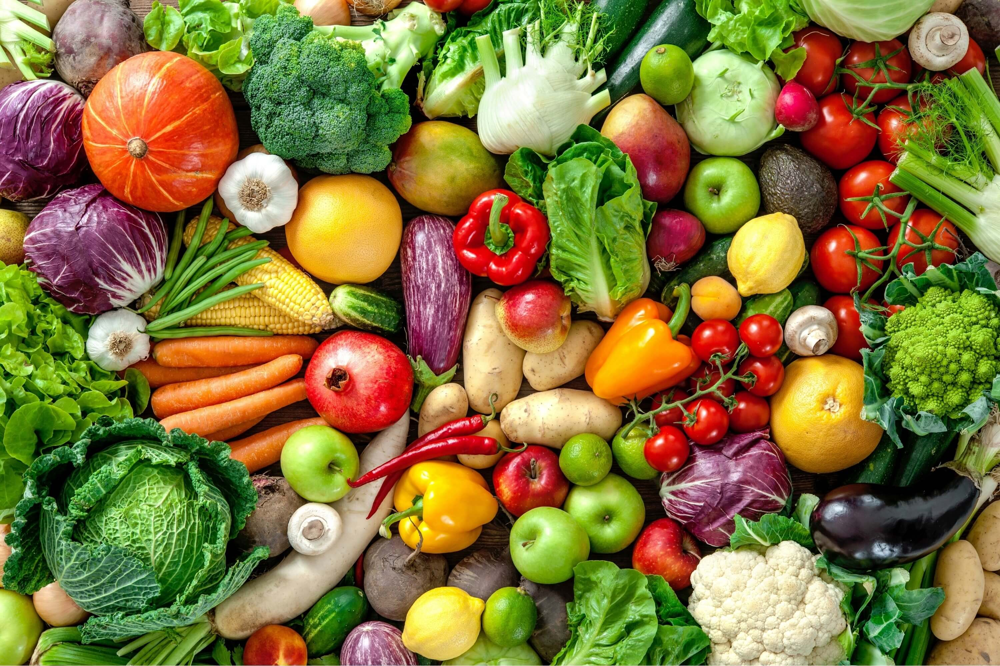

In [6]:
img = url2bytes(fruit_img_url)

# Display the image using cv2_imshow
if img is not None:
    cv2_imshow(img)
else:
    print("Error loading image")

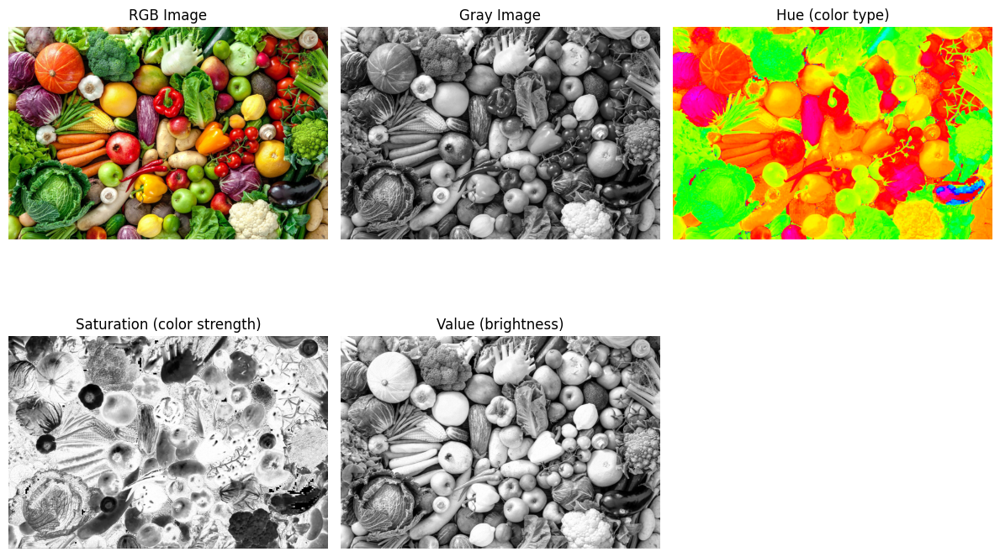

In [7]:
import cv2
from matplotlib import pyplot as plt

# 轉換成不同顏色空間
rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

# 分離 HSV 三個通道
h, s, v = cv2.split(hsv)

# 顯示結果
plt.figure(figsize=(12,8))

plt.subplot(2,3,1); plt.imshow(rgb); plt.title("RGB Image"); plt.axis('off')
plt.subplot(2,3,2); plt.imshow(gray, cmap='gray'); plt.title("Gray Image"); plt.axis('off')
plt.subplot(2,3,3); plt.imshow(h, cmap='hsv'); plt.title("Hue (color type)"); plt.axis('off')
plt.subplot(2,3,4); plt.imshow(s, cmap='gray'); plt.title("Saturation (color strength)"); plt.axis('off')
plt.subplot(2,3,5); plt.imshow(v, cmap='gray'); plt.title("Value (brightness)"); plt.axis('off')

plt.tight_layout()
plt.show()


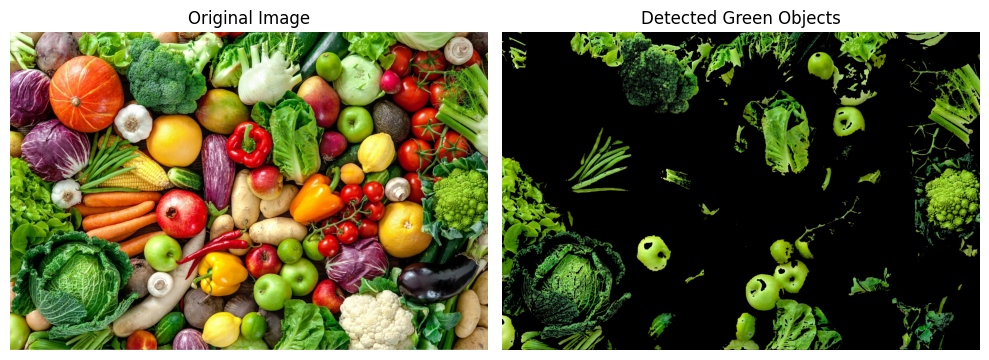

In [8]:
# Convert the image to HSV color space
hsv_img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

# Define the lower and upper bounds for green color in HSV
# These values might need adjustment depending on the specific shade of green
lower_green = np.array([35, 100, 100])
upper_green = np.array([85, 255, 255])

# Create a mask using the inRange function
mask = cv2.inRange(hsv_img, lower_green, upper_green)

# Apply the mask to the original image
green_objects = cv2.bitwise_and(img, img, mask=mask)

# Display the original image and the result
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(green_objects, cv2.COLOR_BGR2RGB))
plt.title('Detected Green Objects')
plt.axis('off')

plt.tight_layout()
plt.show()

# Gaussian Blur

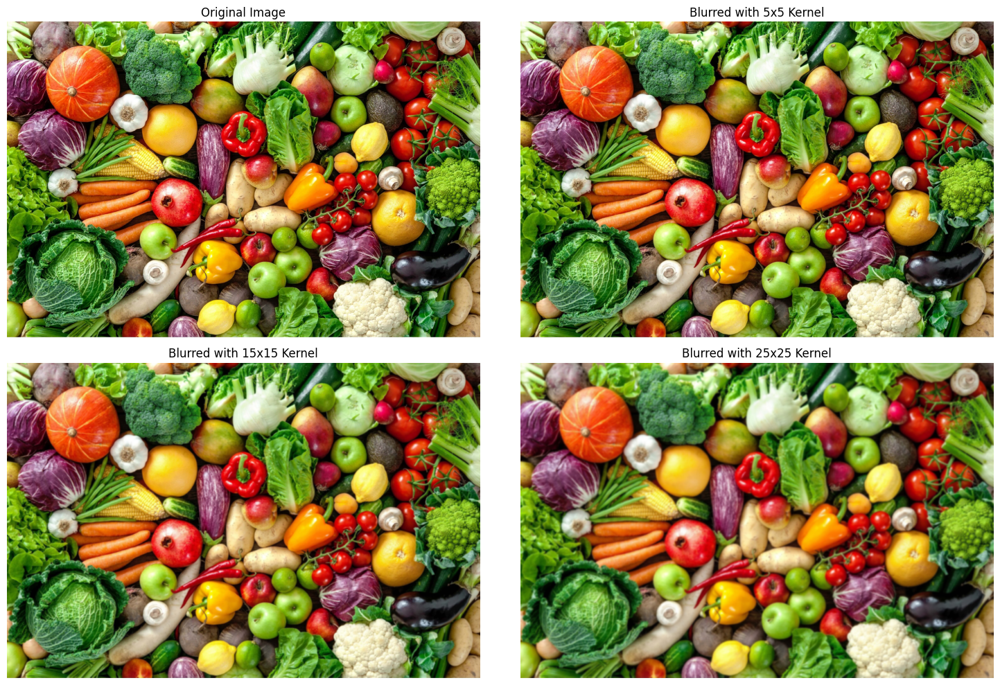

In [9]:
blurred_5x5 = cv2.GaussianBlur(img, (5,5), 0)
blurred_15x15 = cv2.GaussianBlur(img, (15,15), 0)
blurred_25x25 = cv2.GaussianBlur(img, (25,25), 0)

plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(cv2.cvtColor(blurred_5x5, cv2.COLOR_BGR2RGB))
plt.title('Blurred with 5x5 Kernel')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(cv2.cvtColor(blurred_15x15, cv2.COLOR_BGR2RGB))
plt.title('Blurred with 15x15 Kernel')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(cv2.cvtColor(blurred_25x25, cv2.COLOR_BGR2RGB))
plt.title('Blurred with 25x25 Kernel')
plt.axis('off')

plt.tight_layout()
plt.show()

# Image Pyraminds

## Operation of cv2.pyrDwn()

1. Blur
2. Downsampling

## why blur first? -> Aliasing 發生混疊


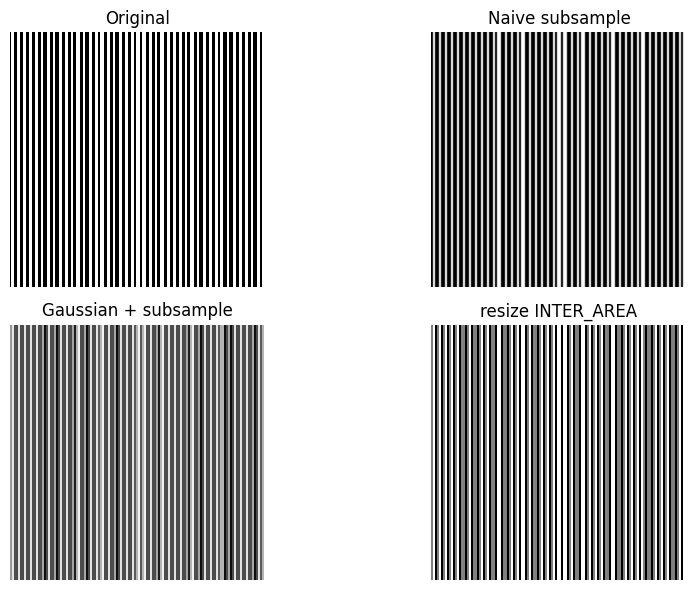

In [10]:
import cv2, numpy as np
from matplotlib import pyplot as plt

# 產生一張容易出現混疊的「細條紋」測試圖
h, w = 256, 256
x = np.arange(w)
stripe = ((np.sin(2*np.pi * x / 6) > 0)*255).astype(np.uint8)  # 週期=6像素，偏高頻
img = np.tile(stripe, (h,1))
img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)

# A) 直接取樣（錯誤示範，會混疊）
down_naive = img[::2, ::2]

# B) 先做 Gaussian（抗混疊）再取樣
blur = cv2.GaussianBlur(img, (5,5), 1.0)
down_aa = blur[::2, ::2]

# C) 用 INTER_AREA（含抗鋸齒）
down_area = cv2.resize(img, (w//2, h//2), interpolation=cv2.INTER_AREA)

plt.figure(figsize=(10,6))
plt.subplot(2,2,1); plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)); plt.title("Original"); plt.axis('off')
plt.subplot(2,2,2); plt.imshow(cv2.cvtColor(down_naive, cv2.COLOR_BGR2RGB)); plt.title("Naive subsample"); plt.axis('off')
plt.subplot(2,2,3); plt.imshow(cv2.cvtColor(down_aa, cv2.COLOR_BGR2RGB)); plt.title("Gaussian + subsample"); plt.axis('off')
plt.subplot(2,2,4); plt.imshow(cv2.cvtColor(down_area, cv2.COLOR_BGR2RGB)); plt.title("resize INTER_AREA"); plt.axis('off')
plt.tight_layout(); plt.show()


## Pyramind

              ┌──────────────────────────────┐
              │         原始影像 G₀          │
              └────────────┬─────────────────┘
                           │  (pyrDown：Gaussian Blur + Downsample)
                           ▼
                     G₁ = ↓G₀（低頻模糊版）
                           │
                           │──► [建立 L₀]  =  G₀ − pyrUp(G₁)
                           ▼
                     G₂ = ↓G₁
                           │
                           │──► [建立 L₁]  =  G₁ − pyrUp(G₂)
                           ▼
                     G₃ = ↓G₂
                           │
                           │──► [建立 L₂]  =  G₂ − pyrUp(G₃)
                           ▼
                     ...（直到最小層）


          ┌──────────────────────────────┐
          │     最底層 Gaussian G₃        │
          └────────────┬─────────────────┘
                       │  (pyrUp：Upsample + Blur)
                       ▼
                 ↑G₃ + L₂  →  重建 G₂
                       │
                       ▼
                 ↑G₂ + L₁  →  重建 G₁
                       │
                       ▼
                 ↑G₁ + L₀  →  重建 G₀ ≈ 原圖


* G₃' = G₃
* G₂' = pyrUp(G₃') + L₂
* G₁' = pyrUp(G₂') + L₁
* G₀' = pyrUp(G₁') + L₀


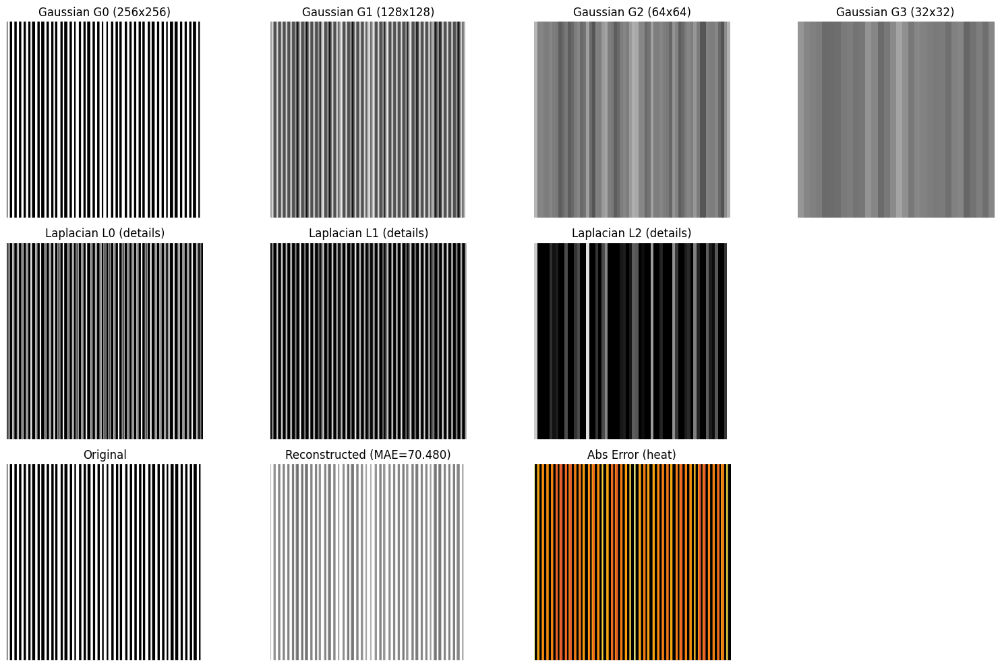

In [11]:


# How many pyramid levels (not counting level 0 = original)
LEVELS = 3  # you can try 4 as well

# --- 1) Build Gaussian pyramid
G = img.copy()
gauss = [G]
for i in range(LEVELS):
    G = cv2.pyrDown(G)
    gauss.append(G)

# --- 2) Build Laplacian pyramid
lap = []
for i in range(len(gauss)-1):
    # Upsample next Gaussian to current size
    up = cv2.pyrUp(gauss[i+1], dstsize=(gauss[i].shape[1], gauss[i].shape[0]))
    L = cv2.subtract(gauss[i], up)
    lap.append(L)
# Note: the last "base" is the smallest Gaussian (low-frequency base)
lap_base = gauss[-1].copy()

# --- 3) Reconstruct from Laplacian levels
recon = lap_base.copy()
for i in range(len(lap)-1, -1, -1):  # from smallest to largest
    recon = cv2.pyrUp(recon, dstsize=(lap[i].shape[1], lap[i].shape[0]))
    recon = cv2.add(recon, lap[i])

# --- 4) Compute reconstruction error
abs_err = cv2.absdiff(img, recon)
mae = abs_err.mean()

# --- 5) Visualize
def bgr2rgb(x): return cv2.cvtColor(x, cv2.COLOR_BGR2RGB)

cols = max(LEVELS+1, 4)
plt.figure(figsize=(4*cols, 10))

# Row 1: Gaussian pyramid
for i, G in enumerate(gauss):
    plt.subplot(3, cols, i+1)
    plt.imshow(bgr2rgb(G))
    plt.title(f"Gaussian G{i} ({G.shape[1]}x{G.shape[0]})")
    plt.axis('off')

# Row 2: Laplacian pyramid (detail bands)
for i, L in enumerate(lap):
    # Normalize for display (L can be negative values after subtraction)
    L_disp = cv2.normalize(L, None, 0, 255, cv2.NORM_MINMAX)
    L_disp = L_disp.astype(np.uint8)
    plt.subplot(3, cols, cols + i + 1)
    plt.imshow(bgr2rgb(L_disp))
    plt.title(f"Laplacian L{i} (details)")
    plt.axis('off')

# Row 3: Original, Reconstructed, Error heatmap
plt.subplot(3, cols, 2*cols + 1); plt.imshow(bgr2rgb(img)); plt.title("Original"); plt.axis('off')
plt.subplot(3, cols, 2*cols + 2); plt.imshow(bgr2rgb(recon)); plt.title(f"Reconstructed (MAE={mae:.3f})"); plt.axis('off')
err_vis = cv2.cvtColor(abs_err, cv2.COLOR_BGR2GRAY)
err_vis = cv2.normalize(err_vis, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
plt.subplot(3, cols, 2*cols + 3); plt.imshow(err_vis, cmap='inferno'); plt.title("Abs Error (heat)"); plt.axis('off')

plt.tight_layout()
plt.show()


## Pyramid Blending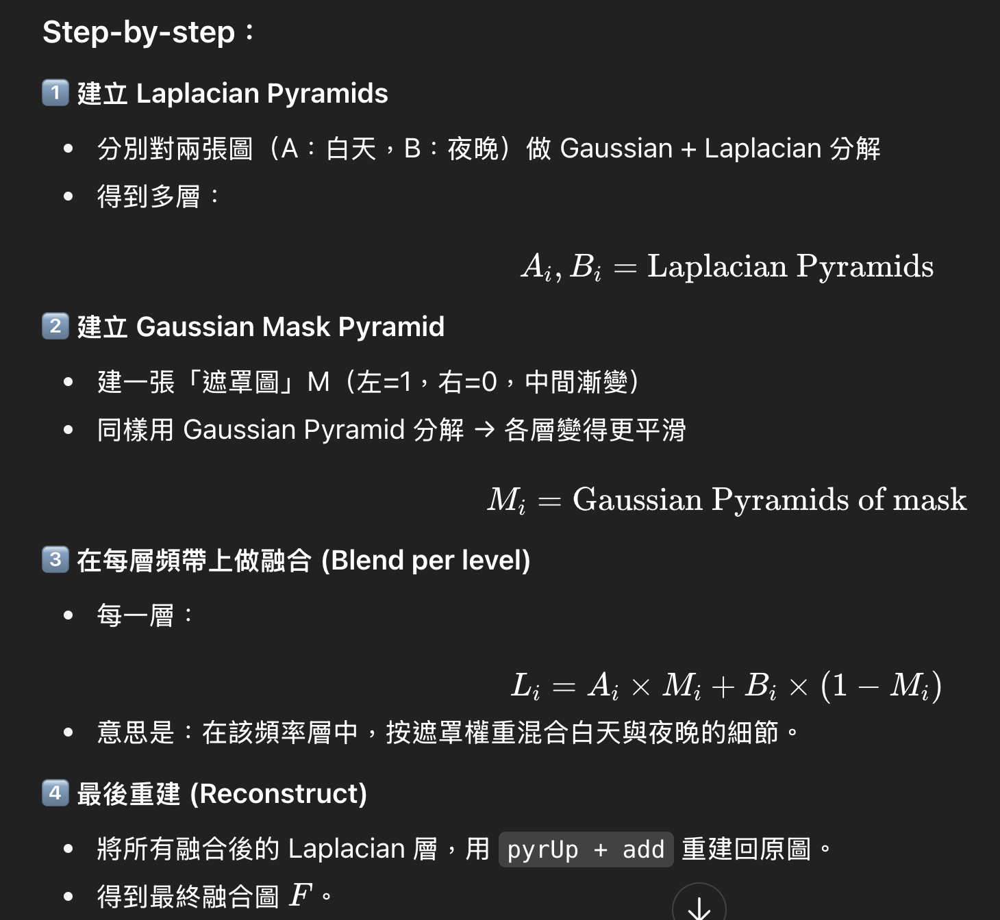

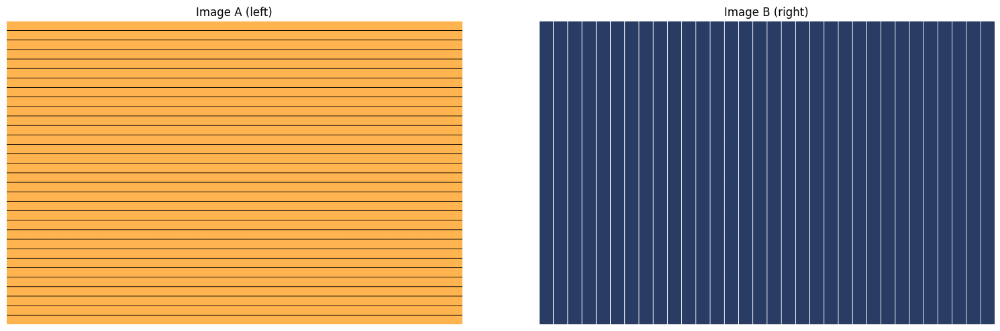

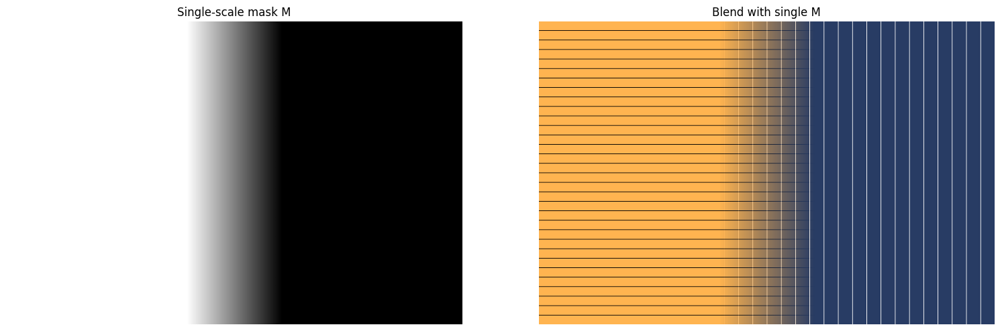

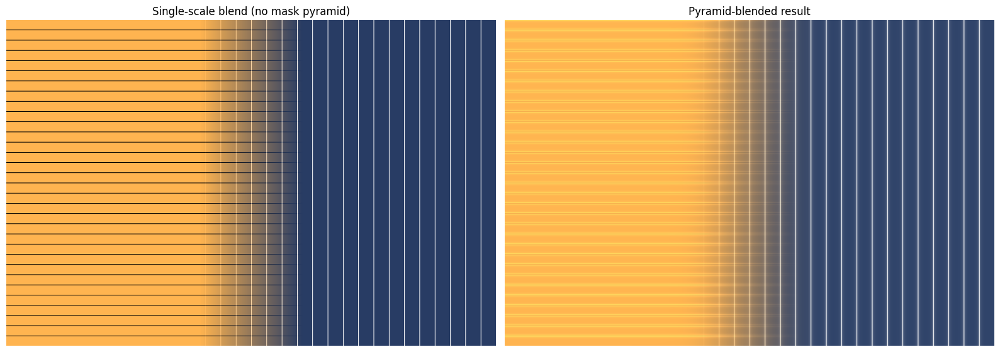

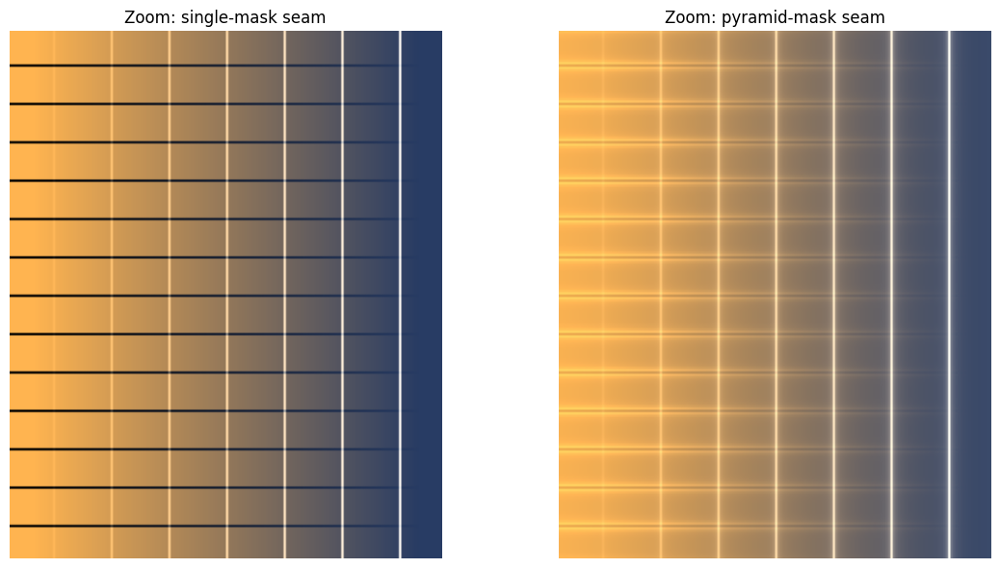

In [12]:
import cv2, numpy as np
import matplotlib.pyplot as plt

# ---------- 0) helper: show images nicely ----------
def imshow_row(titles_imgs, row=1, figsize=(16,5), cmap=None):
    n = len(titles_imgs)
    plt.figure(figsize=figsize)
    for i,(t,im) in enumerate(titles_imgs,1):
        if im.ndim==2: plt.subplot(row,n,i); plt.imshow(im, cmap=cmap); plt.title(t); plt.axis('off')
        else: plt.subplot(row,n,i); plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB)); plt.title(t); plt.axis('off')
    plt.tight_layout(); plt.show()

# ---------- 1) build two test images A (left) & B (right) ----------
H, W = 512, 768

# A: bright, warm; B: dark, cool; add textures to stress blending
A = np.zeros((H,W,3), np.uint8); A[:] = (80,180,255)                 # orange-ish
B = np.zeros((H,W,3), np.uint8); B[:] = (100,60,40)                  # brown/blue-ish
# draw textures
for y in range(0,H,16):
    cv2.line(A, (0,y), (W,y), (0,0,0), 1)
for x in range(0,W,24):
    cv2.line(B, (x,0), (x,H), (255,255,255), 1)

imshow_row([("Image A (left)",A), ("Image B (right)",B)])

# ---------- 2) build a single hard-to-soft 1D mask M at full res ----------
# M transitions from 1 (use A) to 0 (use B) across a band.
band_center = W//2
band_width  = 160  # try 60, 160, 280
x = np.arange(W, dtype=np.float32)
t = np.clip((band_center + band_width/2 - x) / band_width, 0, 1)   # 1→0
M = np.tile(t, (H,1))                                              # HxW
M3 = np.dstack([M,M,M])                                            # 3 channels

# quick preview of the single-scale mask effect (no pyramids)
blend_single = (A.astype(np.float32)*M3 + B.astype(np.float32)*(1-M3)).astype(np.uint8)
imshow_row([("Single-scale mask M", (M*255).astype(np.uint8)),
            ("Blend with single M", blend_single)], cmap='gray')

# ---------- 3) Laplacian pyramids for A and B ----------
LEVELS = 5  # try changing to 4 or 6

def gauss_pyr(img, levels):
    G = [img]
    for _ in range(levels):
        img = cv2.pyrDown(img)
        G.append(img)
    return G

def lap_pyr(img, levels):
    G = gauss_pyr(img, levels)
    L = []
    for i in range(len(G)-1):
        up = cv2.pyrUp(G[i+1], dstsize=(G[i].shape[1], G[i].shape[0]))
        L.append(cv2.subtract(G[i], up))
    base = G[-1]
    return L, base

LA, baseA = lap_pyr(A, LEVELS)
LB, baseB = lap_pyr(B, LEVELS)

# ---------- 4) Build a Gaussian Mask Pyramid (key point!) ----------
# Start from the full-res mask M, then pyrDown repeatedly
def gauss_mask_pyr(mask_f32, levels):
    Gm = [mask_f32]
    m = mask_f32
    for _ in range(levels):
        m = cv2.pyrDown(m)
        Gm.append(m)
    return Gm

# mask as single-channel float32 in [0,1]
Gm = gauss_mask_pyr(M.astype(np.float32), LEVELS)

# ---------- 5) Blend per level: (LapA_i * M_i + LapB_i * (1-M_i)) ----------
L_blend = []
for i in range(len(LA)):
    Mi = cv2.resize(Gm[i], (LA[i].shape[1], LA[i].shape[0]))   # safety align
    Mi3 = np.dstack([Mi,Mi,Mi]).astype(np.float32)
    La = LA[i].astype(np.float32)
    Lb = LB[i].astype(np.float32)
    L_blend.append( (La*Mi3 + Lb*(1.0-Mi3)).astype(np.float32) )

# base blend (lowest Gaussian level) with lowest mask
Mb = cv2.resize(Gm[-1], (baseA.shape[1], baseA.shape[0]))
Mb3 = np.dstack([Mb,Mb,Mb]).astype(np.float32)
base_blend = (baseA.astype(np.float32)*Mb3 + baseB.astype(np.float32)*(1.0-Mb3)).astype(np.float32)

# ---------- 6) Reconstruct final blend from pyramid ----------
recon = base_blend
for i in reversed(range(len(L_blend))):
    recon = cv2.pyrUp(recon, dstsize=(L_blend[i].shape[1], L_blend[i].shape[0]))
    recon = cv2.add(recon, L_blend[i])
recon = np.clip(recon, 0, 255).astype(np.uint8)

# ---------- 7) Compare single-mask vs. pyramid-mask results ----------
imshow_row([
    ("Single-scale blend (no mask pyramid)", blend_single),
    ("Pyramid-blended result", recon)
], figsize=(16,6))

# zoom-in crops near the transition to inspect seams
cx = band_center; w = 180; h = 220; y0 = H//2 - h//2
x0 = max(cx - w//2, 0)
crop_single = blend_single[y0:y0+h, x0:x0+w]
crop_pyr    = recon[y0:y0+h, x0:x0+w]
imshow_row([("Zoom: single-mask seam", crop_single),
            ("Zoom: pyramid-mask seam", crop_pyr)], figsize=(12,6))


# Image Gradients with Sobel

Using existing grayscale image.


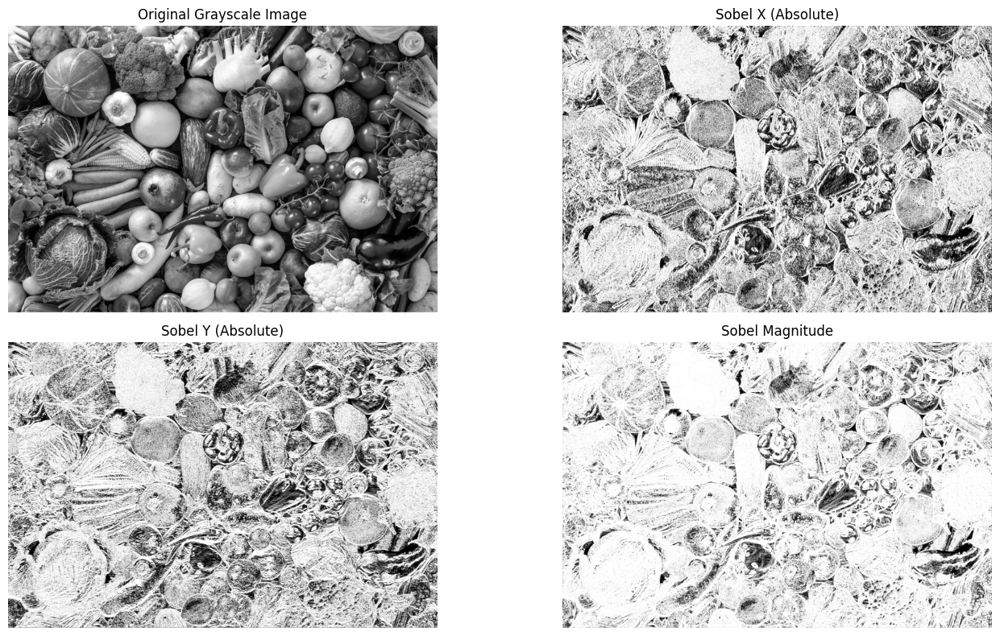

In [13]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

# Use the previously loaded grayscale image if available,
# otherwise load the fruit image and convert to grayscale.
if 'gray' in globals() and gray is not None:
    image_for_sobel = gray.copy()
    print("Using existing grayscale image.")
else:
    print("Loading fruit image and converting to grayscale for Sobel filter.")
    # Assuming fruit_img_url is defined from previous cells
    if 'fruit_img_url' not in globals():
         fruit_img_url = "https://cdn.beautifulpuzzle.com/photos/fresh-fruits-and-vegetables.jpg"

    response = requests.get(fruit_img_url)
    response.raise_for_status()
    image_bytes = BytesIO(response.content)
    image_array = np.asarray(bytearray(image_bytes.read()), dtype=np.uint8)
    img_color = cv2.imdecode(image_array, cv2.IMREAD_COLOR)

    if img_color is not None:
        image_for_sobel = cv2.cvtColor(img_color, cv2.COLOR_BGR2GRAY)
    else:
        print("Error loading image for Sobel filter.")
        # Create a dummy image if loading fails
        image_for_sobel = np.zeros((300, 400), dtype=np.uint8)
        cv2.putText(image_for_sobel, "Image Load Error", (50, 150), cv2.FONT_HERSHEY_SIMPLEX, 1, 255, 2)


if image_for_sobel is not None:
    # --- Apply Sobel filter ---
    # cv2.Sobel(src, ddepth, dx, dy, ksize)
    # src: input image (grayscale recommended)
    # ddepth: output image depth (e.g., cv2.CV_64F to handle negative results)
    # dx: order of the derivative x (1 for x-gradient)
    # dy: order of the derivative y (0 for x-gradient, 1 for y-gradient)
    # ksize: size of the extended Sobel kernel (must be odd)

    # Sobel X-axis
    sobelx = cv2.Sobel(image_for_sobel, cv2.CV_64F, 1, 0, ksize=5)
    # Sobel Y-axis
    sobely = cv2.Sobel(image_for_sobel, cv2.CV_64F, 0, 1, ksize=5)

    # Compute the magnitude of the gradient
    # sqrt(sobelx^2 + sobely^2)
    sobel_magnitude = np.sqrt(sobelx**2 + sobely**2)

    # Convert back to uint8 for display (normalize)
    # Sobel results can be negative, so we use abs and normalize
    sobelx_abs = cv2.convertScaleAbs(sobelx)
    sobely_abs = cv2.convertScaleAbs(sobely)
    sobel_magnitude_uint8 = cv2.convertScaleAbs(sobel_magnitude)


    # --- Visualize ---
    plt.figure(figsize=(15, 8))

    plt.subplot(2, 2, 1)
    plt.imshow(image_for_sobel, cmap='gray')
    plt.title('Original Grayscale Image')
    plt.axis('off')

    plt.subplot(2, 2, 2)
    plt.imshow(sobelx_abs, cmap='gray')
    plt.title('Sobel X (Absolute)')
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.imshow(sobely_abs, cmap='gray')
    plt.title('Sobel Y (Absolute)')
    plt.axis('off')

    plt.subplot(2, 2, 4)
    plt.imshow(sobel_magnitude_uint8, cmap='gray')
    plt.title('Sobel Magnitude')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

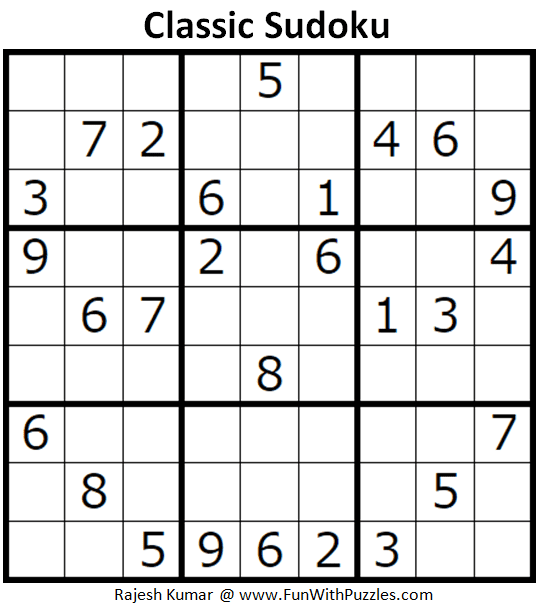

In [14]:
sudo_url = "https://blogger.googleusercontent.com/img/b/R29vZ2xl/AVvXsEhfQHNo4387gLAhd61H8v1St5Bsqr8OLvzNYBx3WLkSbbah9xctWfqTzhRzvrhrBB7t1YrHFk03LqMvraYX_Cg9ILoifPjiFHsJP295cOSzb0Ry9UQWLXifK_XL8lQf7fjJX9Dd1ar0yrET/s640/classic-sudoku-puzzle-asc2018-theme-smileplease.png"
img = url2bytes(sudo_url)
cv2_imshow(img)

Using existing color image and converting to grayscale.


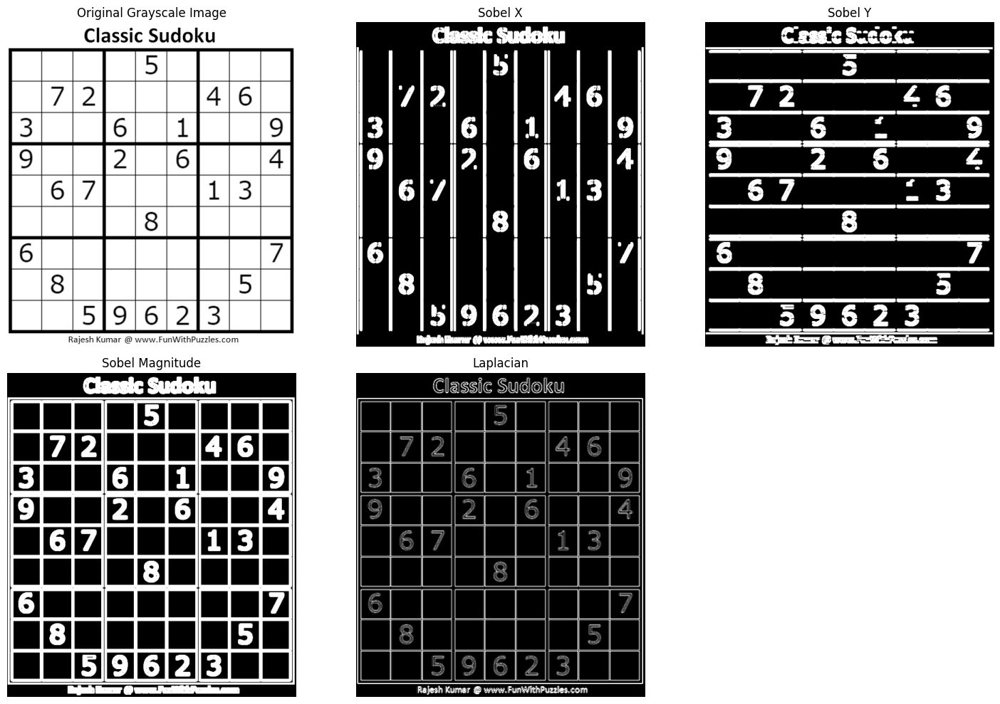

In [15]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

# load a sample image and convert to grayscale.
if 'img' in globals() and img is not None and img.ndim == 3:
    # If color image is available, convert it to grayscale
    image_for_filters = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    print("Using existing color image and converting to grayscale.")
else:
    print("Loading a sample image and converting to grayscale for filters.")
    # Load a sample image (e.g., the sudoku image from earlier)
    if 'sudo_url' not in globals():
         sudo_url = "https://upload.wikimedia.org/wikipedia/commons/thumb/e/e0/Sudoku_Puzzle_by_L2G-20050714_standardized_layout.svg/250px-Sudoku_Puzzle_by_L2G-20050714_standardized_layout.svg.png"

    response = requests.get(sudo_url)
    response.raise_for_status()
    image_bytes = BytesIO(response.content)
    image_array = np.asarray(bytearray(image_bytes.read()), dtype=np.uint8)
    img_color = cv2.imdecode(image_array, cv2.IMREAD_COLOR)

    if img_color is not None:
        image_for_filters = cv2.cvtColor(img_color, cv2.COLOR_BGR2GRAY)
    else:
        print("Error loading sample image for filters.")
        # Create a dummy image if loading fails
        image_for_filters = np.zeros((300, 400), dtype=np.uint8)
        cv2.putText(image_for_filters, "Image Load Error", (50, 150), cv2.FONT_HERSHEY_SIMPLEX, 1, 255, 2)


if image_for_filters is not None:
    # --- Apply Sobel filter ---
    # cv2.Sobel(src, ddepth, dx, dy, ksize)
    # ddepth: output image depth (cv2.CV_64F to handle negative results)
    # dx, dy: order of the derivative (1 for x or y, 0 otherwise)
    # ksize: size of the extended Sobel kernel (must be odd, like 3, 5, 7)

    sobelx = cv2.Sobel(image_for_filters, cv2.CV_64F, 1, 0, ksize=5)
    sobely = cv2.Sobel(image_for_filters, cv2.CV_64F, 0, 1, ksize=5)
    sobel_magnitude = np.sqrt(sobelx**2 + sobely**2)

    # Convert back to uint8 for display (take absolute and normalize)
    sobelx_abs = cv2.convertScaleAbs(sobelx)
    sobely_abs = cv2.convertScaleAbs(sobely)
    sobel_magnitude_uint8 = cv2.convertScaleAbs(sobel_magnitude)


    # --- Apply Laplacian filter ---
    # cv2.Laplacian(src, ddepth, ksize)
    # ddepth: output image depth (cv2.CV_64F recommended)
    # ksize: size of the kernel (must be odd, default is 1)

    laplacian = cv2.Laplacian(image_for_filters, cv2.CV_64F)

    # Convert back to uint8 for display (take absolute and normalize)
    laplacian_abs = cv2.convertScaleAbs(laplacian)


    # --- Visualize ---
    plt.figure(figsize=(15, 10))

    plt.subplot(2, 3, 1)
    plt.imshow(image_for_filters, cmap='gray')
    plt.title('Original Grayscale Image')
    plt.axis('off')

    plt.subplot(2, 3, 2)
    plt.imshow(sobelx_abs, cmap='gray')
    plt.title('Sobel X')
    plt.axis('off')

    plt.subplot(2, 3, 3)
    plt.imshow(sobely_abs, cmap='gray')
    plt.title('Sobel Y')
    plt.axis('off')

    plt.subplot(2, 3, 4)
    plt.imshow(sobel_magnitude_uint8, cmap='gray')
    plt.title('Sobel Magnitude')
    plt.axis('off')

    plt.subplot(2, 3, 5)
    plt.imshow(laplacian_abs, cmap='gray')
    plt.title('Laplacian')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# Canny Edge Detection

Using existing grayscale image.


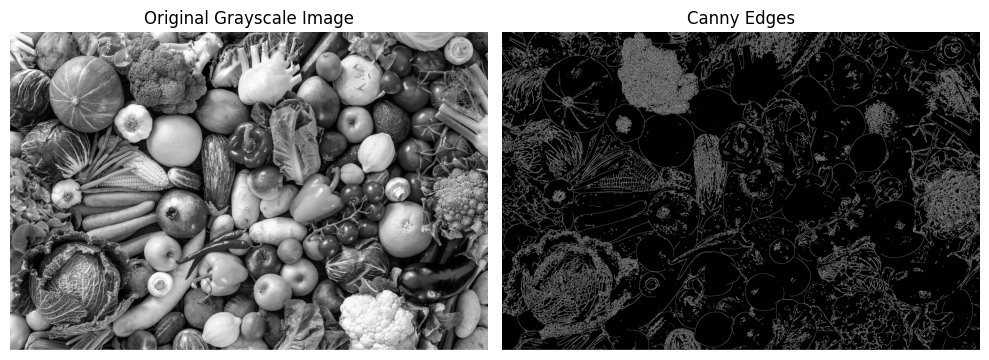

In [16]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

# Use the previously loaded grayscale image if available,
# otherwise load the fruit image and convert to grayscale.
if 'gray' in globals() and gray is not None:
    image_for_canny = gray.copy()
    print("Using existing grayscale image.")
elif 'img' in globals() and img is not None and img.ndim == 3:
    # If color image is available, convert it to grayscale
    image_for_canny = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    print("Using existing color image and converting to grayscale.")
else:
    print("Loading fruit image and converting to grayscale for Canny edge detection.")
    # Assuming fruit_img_url is defined from previous cells
    if 'fruit_img_url' not in globals():
         fruit_img_url = "https://cdn.beautifulpuzzle.com/photos/fresh-fruits-and-vegetables.jpg"

    response = requests.get(fruit_img_url)
    response.raise_for_status()
    image_bytes = BytesIO(response.content)
    image_array = np.asarray(bytearray(image_bytes.read()), dtype=np.uint8)
    img_color = cv2.imdecode(image_array, cv2.IMREAD_COLOR)

    if img_color is not None:
        image_for_canny = cv2.cvtColor(img_color, cv2.COLOR_BGR2GRAY)
    else:
        print("Error loading image for Canny edge detection.")
        # Create a dummy image if loading fails
        image_for_canny = np.zeros((300, 400), dtype=np.uint8)
        cv2.putText(image_for_canny, "Image Load Error", (50, 150), cv2.FONT_HERSHEY_SIMPLEX, 1, 255, 2)


if image_for_canny is not None:
    # --- Apply Canny Edge Detector ---
    # cv2.Canny(image, threshold1, threshold2)
    # image: grayscale input image
    # threshold1: lower hysteresis threshold
    # threshold2: upper hysteresis threshold

    # Recommended ratio threshold2:threshold1 is 2:1 or 3:1
    edges = cv2.Canny(image_for_canny, 100, 200)

    # --- Visualize ---
    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.imshow(image_for_canny, cmap='gray')
    plt.title('Original Grayscale Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(edges, cmap='gray')
    plt.title('Canny Edges')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

Loaded fallback fruit image.
Found 11663 contours.


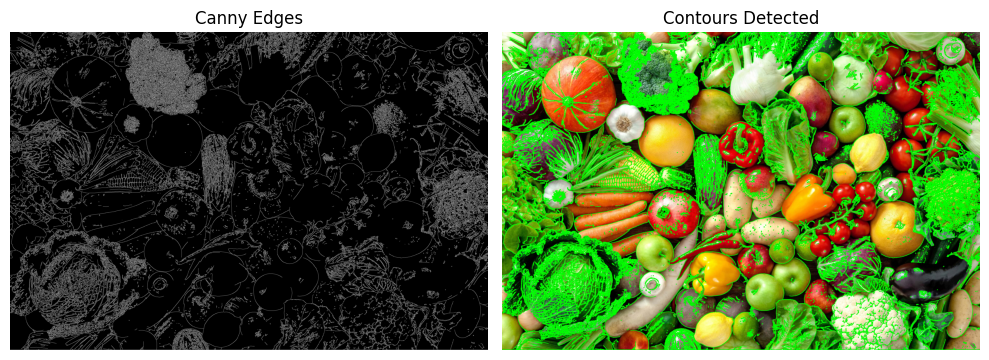

In [17]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

# Assuming 'edges' (from cv2.Canny) and 'img' (original color image) are available
# from previous cells.
# If not, we would need to regenerate them or load an image here.

if 'edges' not in globals() or edges is None:
    print("Canny edges not found. Please run the previous cell to generate edges.")
    # Create dummy edges or handle error
    if 'image_for_canny' in globals() and image_for_canny is not None:
         edges = cv2.Canny(image_for_canny, 100, 200)
         print("Generated edges from existing grayscale image.")
    else:
        print("Cannot proceed without an image and its edges.")
        # Exit or handle error appropriately
        edges = np.zeros((100, 100), dtype=np.uint8) # Create dummy



if 'fruit_img_url' not in globals():
    fruit_img_url = "https://cdn.beautifulpuzzle.com/photos/fresh-fruits-and-vegetables.jpg"
try:
    response = requests.get(fruit_img_url)
    response.raise_for_status()
    image_bytes = BytesIO(response.content)
    image_array = np.asarray(bytearray(image_bytes.read()), dtype=np.uint8)
    img = cv2.imdecode(image_array, cv2.IMREAD_COLOR)
    print("Loaded fallback fruit image.")
except Exception as e:
    print(f"Error loading fallback image: {e}")
    img = np.zeros((edges.shape[0], edges.shape[1], 3), dtype=np.uint8) # Create dummy color image


if img is not None and edges is not None:
    # Ensure img is color for drawing contours
    if img.ndim == 2:
        img_display = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
    else:
        img_display = img.copy()


    # --- Find Contours ---
    # cv2.findContours(image, mode, method)
    # image: Source 8-bit single-channel image (like the output of Canny)
    # mode: Contour retrieval mode (e.g., cv2.RETR_EXTERNAL, cv2.RETR_LIST, cv2.RETR_TREE)
    # method: Contour approximation method (e.g., cv2.CHAIN_APPROX_NONE, cv2.CHAIN_APPROX_SIMPLE)

    # We use RETR_EXTERNAL to retrieve only the extreme outer contours
    # We use CHAIN_APPROX_SIMPLE to compress horizontal, vertical, and diagonal segments
    contours, hierarchy = cv2.findContours(edges.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    print(f"Found {len(contours)} contours.")

    # --- Draw Contours ---
    # cv2.drawContours(image, contours, contourIdx, color, thickness)
    # image: Destination image (where contours will be drawn)
    # contours: List of contours
    # contourIdx: Index of the contour to draw (-1 to draw all)
    # color: Color of the contours (BGR)
    # thickness: Thickness of the contour lines (-1 to fill)

    # Draw all contours in green
    cv2.drawContours(img_display, contours, -1, (0, 255, 0), 2)


    # --- Visualize ---
    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.imshow(edges, cmap='gray')
    plt.title('Canny Edges')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(img_display, cv2.COLOR_BGR2RGB))
    plt.title('Contours Detected')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

#Lane detection


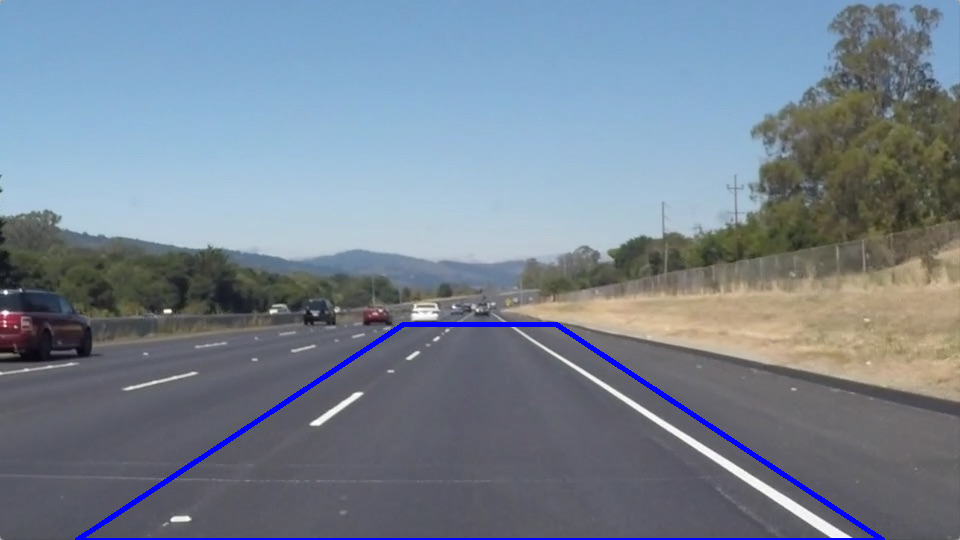

Input Image with ROI:


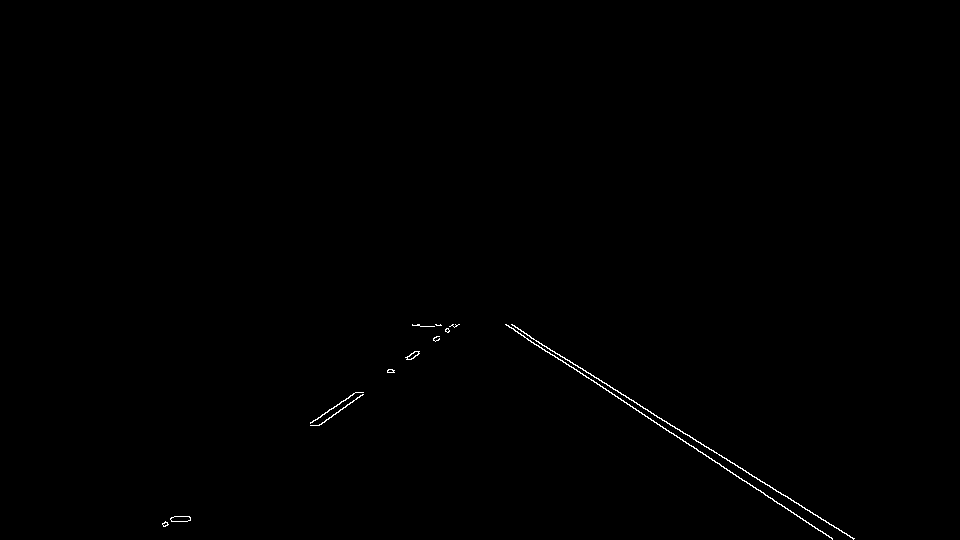

Canny (ROI):


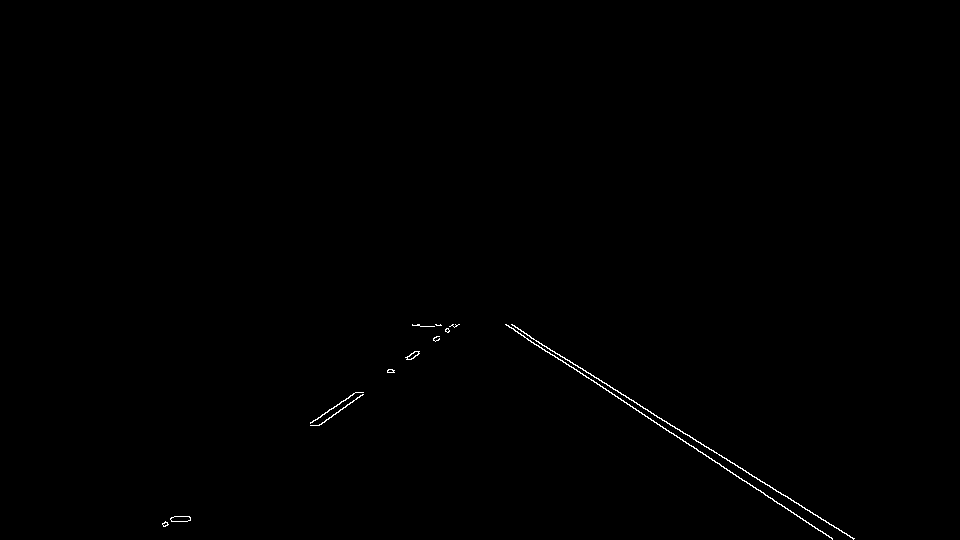

Processed:


In [18]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import requests
from io import BytesIO


# === 參數 ===
IMG_URL = "https://raw.githubusercontent.com/bob800530/Find_lane_line/refs/heads/master/test_images/solidWhiteRight.jpg" # Use the image URL here
CANNY_LO, CANNY_HI = 50, 150    # Canny 雙閾值
USE_CLOSING = False              # 是否套用閉運算
KERNEL_SIZE = 5                 # 閉運算 kernel 大小（奇數）
HOUGH_THRESHOLD = 50            # Hough 票數門檻
MIN_LINE_LEN = 60               # 最短線段
MAX_LINE_GAP = 120              # 線段間最大間隙
SLOPE_MIN_ABS = 0.3             # 過濾過於水平的線（|斜率| 太小的丟掉）

# === Step 1. 讀圖與前處理 ===
# Fetch the image from the URL
try:
    response = requests.get(IMG_URL)
    response.raise_for_status() # Raise an exception for bad status codes
    image_bytes = BytesIO(response.content)
    image_array = np.asarray(bytearray(image_bytes.read()), dtype=np.uint8)
    img = cv2.imdecode(image_array, cv2.IMREAD_COLOR)
    if img is None:
         raise Exception("Failed to decode image from URL")
except Exception as e:
    print(f"Error loading image from URL: {e}")
    # Create a dummy black image if loading fails
    img = np.zeros((500, 500, 3), dtype=np.uint8)
    cv2.putText(img, "Image Load Error", (50, 250), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)


h, w = img.shape[:2]
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
blur = cv2.GaussianBlur(gray, (5, 5), 0)

# === Step 2. Canny 邊緣 ===
edges = cv2.Canny(blur, CANNY_LO, CANNY_HI)

# === Step 3. ROI 遮罩（梯形：下寬上窄） ===
mask = np.zeros_like(edges)
roi = np.array([[
    (int(0.08*w), h),                 # 左下
    (int(0.92*w), h),                 # 右下
    (int(0.58*w), int(0.6*h)),        # 右上
    (int(0.42*w), int(0.6*h))         # 左上
]], dtype=np.int32)
cv2.fillPoly(mask, roi, 255)
roi_edges = cv2.bitwise_and(edges, mask)

# === Step 4.（可選）閉運算：補縫/連通 ===
proc = roi_edges.copy()
if USE_CLOSING:
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (KERNEL_SIZE, KERNEL_SIZE))
    proc = cv2.morphologyEx(proc, cv2.MORPH_CLOSE, kernel, iterations=1)

# === Step 5. HoughLinesP 擬合線段 ===
lines = cv2.HoughLinesP(
    proc,
    rho=1,
    theta=np.pi/180,
    threshold=HOUGH_THRESHOLD,
    minLineLength=MIN_LINE_LEN,
    maxLineGap=MAX_LINE_GAP
)

# === 畫線（過濾近水平線，避免雜訊） ===
overlay = img.copy()
if lines is not None:
    for (x1, y1, x2, y2) in lines[:, 0, :]:
        dx, dy = (x2 - x1), (y2 - y1)
        # Avoid division by zero for vertical lines
        if dx == 0:
            slope_abs = float('inf') # Treat vertical lines as having infinite slope
        else:
            slope_abs = abs(dy / dx)

        if slope_abs < SLOPE_MIN_ABS:
            continue
        cv2.line(overlay, (x1, y1), (x2, y2), (0, 255, 0), 6)

# === 顯示（可存檔） ===
# Display the original image with the ROI drawn on it
img_with_roi = img.copy()
# Draw the polygon on the image copy
cv2.polylines(img_with_roi, roi, True, (255, 0, 0), 3) # Draw ROI in Blue with thickness 3

cv2_imshow(img_with_roi)
print("Input Image with ROI:")

cv2_imshow(roi_edges)
print("Canny (ROI):")
cv2_imshow(proc)
print("Processed (after Closing):" if USE_CLOSING else "Processed:")



## Hough Line Transform
Process the video at "https://github.com/P76071226/CV_learning/raw/refs/heads/main/assets/solidYellowLeft.mp4" to detect and draw lane lines on each frame using the existing image processing pipeline, and display the processed video.

### Download the video

#### Subtask:
Download the video file from the provided URL to a local path in the Colab environment.


**Reasoning**:
Download the video file from the provided URL to a local path.



In [19]:
import requests
import os

# Define the video URL and local path
video_url = "https://github.com/P76071226/CV_learning/raw/refs/heads/main/assets/solidYellowLeft.mp4"
local_video_path = 'solidYellowLeft.mp4'

# Send an HTTP GET request to fetch the video content
response = requests.get(video_url, stream=True)
response.raise_for_status() # Raise an exception for bad status codes

# Write the content to the local file
with open(local_video_path, 'wb') as f:
    for chunk in response.iter_content(chunk_size=8192):
        f.write(chunk)

# Print a confirmation message
print(f"Video downloaded successfully to: {local_video_path}")

Video downloaded successfully to: solidYellowLeft.mp4


### Initialize video capture

### Subtask:
Use OpenCV to open the downloaded video file for reading frames.


**Reasoning**:
Use OpenCV to open the downloaded video file for reading frames and check if it was opened successfully.



In [34]:
# Define the local path to the downloaded video file
local_video_path = 'solidYellowLeft.mp4'

# Use cv2.VideoCapture() to create a video capture object
cap = cv2.VideoCapture(local_video_path)

# Check if the video capture object was opened successfully
if not cap.isOpened():
    print(f"Error: Could not open video file {local_video_path}")
else:
    print(f"Video file {local_video_path} opened successfully.")

Video file solidYellowLeft.mp4 opened successfully.


### Process video frames

#### Subtask:
Loop through each frame of the video:
  - Read the current frame.
  - Apply the existing lane detection image processing pipeline (grayscale, blur, Canny, ROI, Hough Transform, line filtering) to the frame.
  - Draw the detected lane lines on the current frame.
  - Display the processed frame.
  - Handle user interruption (e.g., pressing a key to stop the video).


**Reasoning**:
Loop through the video frames, apply the lane detection pipeline, display the processed frame, and handle user interruption.



In [35]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import requests
from io import BytesIO

# Re-defining the pipeline parameters for clarity
CANNY_LO, CANNY_HI = 50, 150    # Canny dual thresholds
USE_CLOSING = False              # Whether to apply morphological closing
KERNEL_SIZE = 5                 # Kernel size for closing (odd)
HOUGH_THRESHOLD = 50            # Hough vote threshold
MIN_LINE_LEN = 60               # Minimum line length
MAX_LINE_GAP = 120              # Maximum line gap
SLOPE_MIN_ABS = 0.3             # Filter out lines that are too horizontal (|slope| is too small)

# Ensure cap is defined and opened from the previous step
if 'cap' not in globals() or not cap.isOpened():
    print("Video capture object 'cap' not found or not opened. Please run the previous step.")
else:
    print("Processing video frames...")

    # Define output video parameters
    output_video_path = 'output_lane_detection_hough.mp4'
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = int(cap.get(cv2.CAP_PROP_FPS))

    # Define the codec and create VideoWriter object
    # Using 'mp4v' codec for MP4 files
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out_video = cv2.VideoWriter(output_video_path, fourcc, fps, (frame_width, frame_height))


    while cap.isOpened():
        # Read a frame from the video
        ret, frame = cap.read()

        # If frame is not read correctly, break the loop
        if not ret:
            print("Can't receive frame (stream end?). Exiting ...")
            break

        # === Apply the existing lane detection pipeline to the frame ===
        h, w = frame.shape[:2]
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        blur = cv2.GaussianBlur(gray, (5, 5), 0)

        # Canny Edge Detection
        edges = cv2.Canny(blur, CANNY_LO, CANNY_HI)

        # ROI Mask (trapezoid: wider at the bottom, narrower at the top)
        mask = np.zeros_like(edges)
        roi = np.array([[
            (int(0.08*w), h),                 # Bottom-left
            (int(0.92*w), h),                 # Bottom-right
            (int(0.58*w), int(0.6*h)),        # Top-right
            (int(0.42*w), int(0.6*h))         # Top-left
        ]], dtype=np.int32)
        cv2.fillPoly(mask, roi, 255)
        roi_edges = cv2.bitwise_and(edges, mask)

        # (Optional) Closing operation: stitching/connecting gaps
        proc = roi_edges.copy()
        if USE_CLOSING:
            kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (KERNEL_SIZE, KERNEL_SIZE))
            proc = cv2.morphologyEx(proc, cv2.MORPH_CLOSE, kernel, iterations=1)

        # HoughLinesP to fit line segments
        lines = cv2.HoughLinesP(
            proc,
            rho=1,
            theta=np.pi/180,
            threshold=HOUGH_THRESHOLD,
            minLineLength=MIN_LINE_LEN,
            maxLineGap=MAX_LINE_GAP
        )

        # Draw lines (filter out near-horizontal lines to avoid noise)
        out = frame.copy() # Draw on a copy of the original frame
        if lines is not None:
            for (x1, y1, x2, y2) in lines[:, 0, :]:
                dx, dy = (x2 - x1), (y2 - y1)
                # Avoid division by zero for vertical lines
                if dx == 0:
                    slope_abs = float('inf') # Treat vertical lines as having infinite slope
                else:
                    slope_abs = abs(dy / dx)

                if slope_abs < SLOPE_MIN_ABS:
                    continue
                cv2.line(out, (x1, y1), (x2, y2), (0, 255, 0), 6) # Draw in Green

        # Write the processed frame to the output video file
        out_video.write(out)


    # Release everything when job is finished
    # cap.release()
    out_video.release()
    # cv2.destroyAllWindows()
    print(f"Video processing finished. Output saved to {output_video_path}")

Processing video frames...
Can't receive frame (stream end?). Exiting ...
Video processing finished. Output saved to output_lane_detection_hough.mp4


## With sliding widows and polyfit

In [22]:
import cv2
import numpy as np

# --- Sliding Window 參數（可調） ---
NWINDOWS = 9       # 垂直視窗數
MARGIN   = 80      # 每層左右搜尋半寬
MINPIX   = 50      # 視窗內至少多少點才重新置中

def sliding_window_polyfit(binary_img, nwindows=NWINDOWS, margin=MARGIN, minpix=MINPIX):
    """在二值圖上做 sliding window，回傳左右二次擬合與曲線點"""
    nonzeroy, nonzerox = binary_img.nonzero()
    # 底部一半做直方圖找左右起點
    histogram = np.sum(binary_img[binary_img.shape[0]//2:, :], axis=0)
    if histogram.sum() == 0:
        return None, None, None, None, None

    midpoint = histogram.shape[0] // 2
    leftx_base  = np.argmax(histogram[:midpoint]) if histogram[:midpoint].sum()  > 0 else None
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint if histogram[midpoint:].sum() > 0 else None

    if leftx_base is None and rightx_base is None:
        return None, None, None, None, None

    window_height = int(binary_img.shape[0] // nwindows)
    leftx_current, rightx_current = leftx_base, rightx_base
    left_lane_inds, right_lane_inds = [], []

    for window in range(nwindows):
        win_y_low  = binary_img.shape[0] - (window + 1) * window_height
        win_y_high = binary_img.shape[0] - window * window_height

        if leftx_current is not None:
            win_xleft_low  = leftx_current - margin
            win_xleft_high = leftx_current + margin
            good_left = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                         (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
            left_lane_inds.append(good_left)
            if len(good_left) > minpix:
                leftx_current = int(np.mean(nonzerox[good_left]))

        if rightx_current is not None:
            win_xright_low  = rightx_current - margin
            win_xright_high = rightx_current + margin
            good_right = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                          (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
            right_lane_inds.append(good_right)
            if len(good_right) > minpix:
                rightx_current = int(np.mean(nonzerox[good_right]))

    left_lane_inds  = np.concatenate(left_lane_inds)  if len(left_lane_inds)  else np.array([], dtype=int)
    right_lane_inds = np.concatenate(right_lane_inds) if len(right_lane_inds) else np.array([], dtype=int)

    leftx, lefty   = nonzerox[left_lane_inds],  nonzeroy[left_lane_inds]
    rightx, righty = nonzerox[right_lane_inds], nonzeroy[right_lane_inds]

    left_fit = right_fit = None
    if len(lefty)  >= 50: left_fit  = np.polyfit(lefty,  leftx,  2)
    if len(righty) >= 50: right_fit = np.polyfit(righty, rightx, 2)

    ploty = np.linspace(0, binary_img.shape[0]-1, binary_img.shape[0])
    left_fitx = right_fitx = None
    if left_fit  is not None:  left_fitx  = left_fit[0]*ploty**2  + left_fit[1]*ploty  + left_fit[2]
    if right_fit is not None:  right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    return left_fit, right_fit, ploty, left_fitx, right_fitx

def draw_polyline_on_frame(frame, ploty, fitx, color=(0,255,0), thickness=6):
    """把 (fitx, ploty) 畫在 frame 上"""
    if ploty is None or fitx is None: return frame
    pts = np.vstack([fitx, ploty]).T.astype(np.int32)
    H, W = frame.shape[:2]
    pts = pts[(pts[:,0] >= 0) & (pts[:,0] < W) & (pts[:,1] >= 0) & (pts[:,1] < H)]
    if len(pts) >= 2:
        cv2.polylines(frame, [pts], False, color, thickness)
    return frame

def get_perspective_mats(w, h):
    """
    定義原圖上的梯形 ROI 映到鳥瞰矩形的映射矩陣 M、逆矩陣 Minv
    你可依資料集微調四點
    """
    src = np.float32([
        [0.08*w, h],      # 左下
        [0.92*w, h],      # 右下
        [0.58*w, 0.60*h], # 右上
        [0.42*w, 0.60*h]  # 左上
    ])
    # 目的地矩形（放中間，避免過度拉伸）
    dst = np.float32([
        [0.25*w, h],
        [0.75*w, h],
        [0.75*w, 0.0],
        [0.25*w, 0.0]
    ])
    M    = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    return M, Minv

def warp_binary(binary_img, M, out_size):
    """把二值圖做透視變換（保持二值）"""
    M = M.astype(np.float32)
    warped = cv2.warpPerspective(binary_img, M, out_size, flags=cv2.INTER_NEAREST)
    return warped

def unwarp_points(x, y, Minv):
    """把鳥瞰座標點陣列反投影回原圖座標"""
    pts = np.vstack([x, y]).T.astype(np.float32).reshape(-1,1,2)
    unwarped = cv2.perspectiveTransform(pts, Minv).reshape(-1,2)
    return unwarped.astype(np.int32)

def draw_lane_area_warpback(base_frame, ploty, leftx, rightx, Minv, color=(0,180,255), alpha=0.35):
    """在鳥瞰平面構出左右線之間的面，反投影回原圖並疊合"""
    if ploty is None or leftx is None or rightx is None:
        return base_frame
    # 構成鳥瞰多邊形（左線往上，右線往下）
    pts_left  = np.vstack([leftx,  ploty]).T
    pts_right = np.vstack([rightx[::-1], ploty[::-1]]).T
    lane_poly_warp = np.vstack([pts_left, pts_right]).astype(np.float32)
    lane_poly_warp = lane_poly_warp.reshape(-1,1,2)
    # 反投影整個多邊形輪廓
    lane_poly_orig = cv2.perspectiveTransform(lane_poly_warp, Minv).astype(np.int32)
    overlay = base_frame.copy()
    cv2.fillPoly(overlay, [lane_poly_orig.reshape(-1,2)], color)
    return cv2.addWeighted(overlay, alpha, base_frame, 1-alpha, 0)




In [27]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import requests
from io import BytesIO

# Re-defining the pipeline parameters for clarity
IMG_URL = "https://raw.githubusercontent.com/bob800530/Find_lane_line/refs/heads/master/test_images/solidWhiteRight.jpg" # This URL is not used for video processing, just kept from previous cell
CANNY_LO, CANNY_HI = 50, 150    # Canny dual thresholds
USE_CLOSING = False              # Whether to apply morphological closing
KERNEL_SIZE = 5                 # Kernel size for closing (odd)
HOUGH_THRESHOLD = 50            # Hough vote threshold
MIN_LINE_LEN = 60               # Minimum line length
MAX_LINE_GAP = 120              # Maximum line gap
SLOPE_MIN_ABS = 0.3             # Filter out lines that are too horizontal (|slope| is too small)
USE_PERSPECTIVE = True
# Ensure cap is defined and opened from the previous step
if 'cap' not in globals() or not cap.isOpened():
    print("Video capture object 'cap' not found or not opened. Please run the previous step.")
else:
    print("Processing video frames...")

    # Define output video parameters
    output_video_path = 'output_lane_detection.mp4'
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = int(cap.get(cv2.CAP_PROP_FPS))

    M, Minv = get_perspective_mats(frame_width, frame_height)

    # Define the codec and create VideoWriter object
    # Using 'mp4v' codec for MP4 files
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out_video = cv2.VideoWriter(output_video_path, fourcc, fps, (frame_width, frame_height))


    while cap.isOpened():
        # Read a frame from the video
        ret, frame = cap.read()

        # If frame is not read correctly, break the loop
        if not ret:
            print("Can't receive frame (stream end?). Exiting ...")
            break

        # === Apply the existing lane detection pipeline to the frame ===
        h, w = frame.shape[:2]
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        blur = cv2.GaussianBlur(gray, (5, 5), 0)

        # Canny Edge Detection
        edges = cv2.Canny(blur, CANNY_LO, CANNY_HI)

        # ROI Mask (trapezoid: wider at the bottom, narrower at the top)
        mask = np.zeros_like(edges)
        roi = np.array([[
            (int(0.08*w), h),                 # Bottom-left
            (int(0.92*w), h),                 # Bottom-right
            (int(0.58*w), int(0.6*h)),        # Top-right
            (int(0.42*w), int(0.6*h))         # Top-left
        ]], dtype=np.int32)
        cv2.fillPoly(mask, roi, 255)
        roi_edges = cv2.bitwise_and(edges, mask)

        # (Optional) Closing operation: stitching/connecting gaps
        proc = roi_edges.copy()
        if USE_CLOSING:
            kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (KERNEL_SIZE, KERNEL_SIZE))
            proc = cv2.morphologyEx(proc, cv2.MORPH_CLOSE, kernel, iterations=1)

        out = frame.copy()

        if USE_PERSPECTIVE:
            # 1) 把二值邊緣圖 warp 成鳥瞰
            warped = warp_binary(proc, M, (frame_width, frame_height))

            # 2) 在鳥瞰圖上做 sliding window + polyfit
            left_fit, right_fit, ploty, left_fitx, right_fitx = sliding_window_polyfit(warped)

            # 3) 把鳥瞰曲線點反投影回原圖並畫線
            if ploty is not None and left_fitx is not None:
                left_pts_orig = unwarp_points(left_fitx, ploty, Minv)
                if len(left_pts_orig) >= 2:
                    cv2.polylines(out, [left_pts_orig], False, (0,255,0), 6)

            if ploty is not None and right_fitx is not None:
                right_pts_orig = unwarp_points(right_fitx, ploty, Minv)
                if len(right_pts_orig) >= 2:
                    cv2.polylines(out, [right_pts_orig], False, (0,255,0), 6)

            # 4)（可選）把左右線之間的區域填色再反投影疊回
            if left_fitx is not None and right_fitx is not None:
                out = draw_lane_area_warpback(out, ploty, left_fitx, right_fitx, Minv,
                                              color=(0,180,255), alpha=0.35)

        else:
            # 不做透視：直接在原本二值圖上 sliding window（可跑，但幾何不準）
            left_fit, right_fit, ploty, left_fitx, right_fitx = sliding_window_polyfit(proc)
            out = draw_polyline_on_frame(out, ploty, left_fitx,  (0,255,0), 6)
            out = draw_polyline_on_frame(out, ploty, right_fitx, (0,255,0), 6)

        # 寫出影格
        out_video.write(out)


    # Release everything when job is finished
    cap.release()
    out_video.release()
    # cv2.destroyAllWindows()
    print(f"Video processing finished. Output saved to {output_video_path}")


Processing video frames...
Can't receive frame (stream end?). Exiting ...
Video processing finished. Output saved to output_lane_detection.mp4
